In [2]:
import pandas as pd
import datetime
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt
data=pd.read_csv('C:\\Users\\disha\\Downloads\\feature_seln_new123.csv')

In [3]:
data.shape

(2952, 43)

In [4]:
data['START_TIME'] = pd.to_datetime(data['START_TIME'])

In [5]:
df=data[data.columns[1:]]
df=df.set_index('START_TIME')

In [6]:
df.shape

(2952, 41)

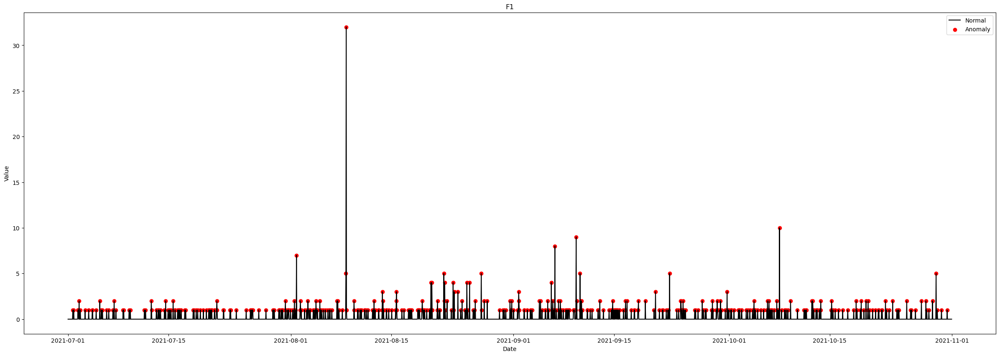

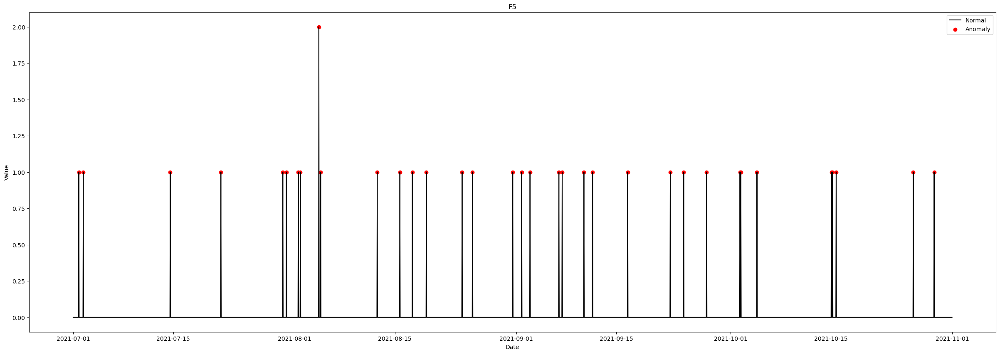

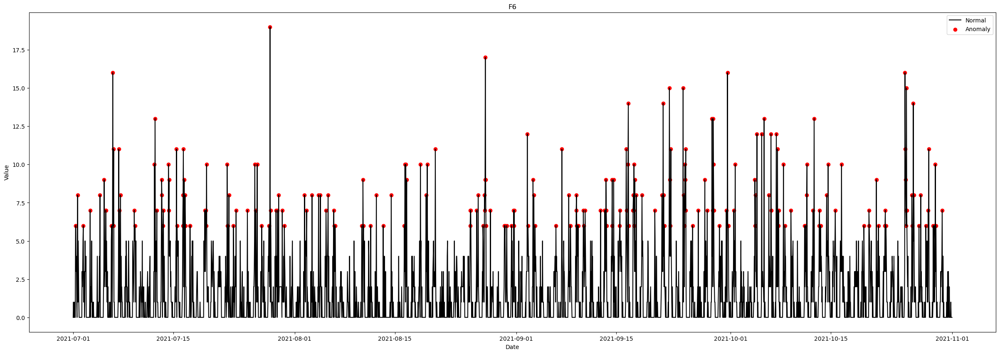

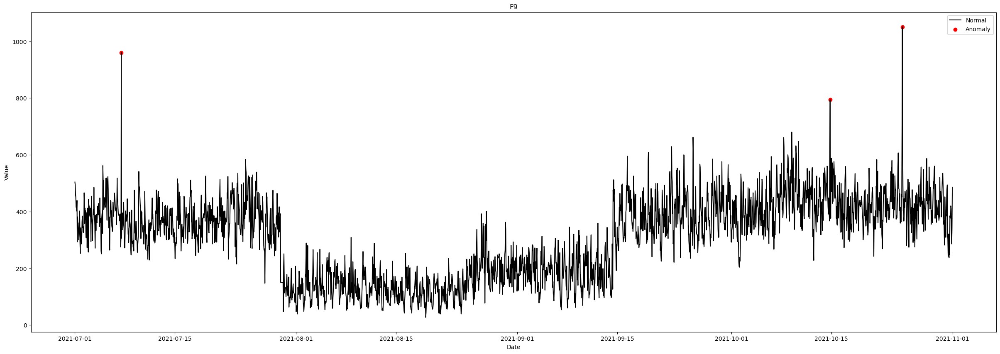

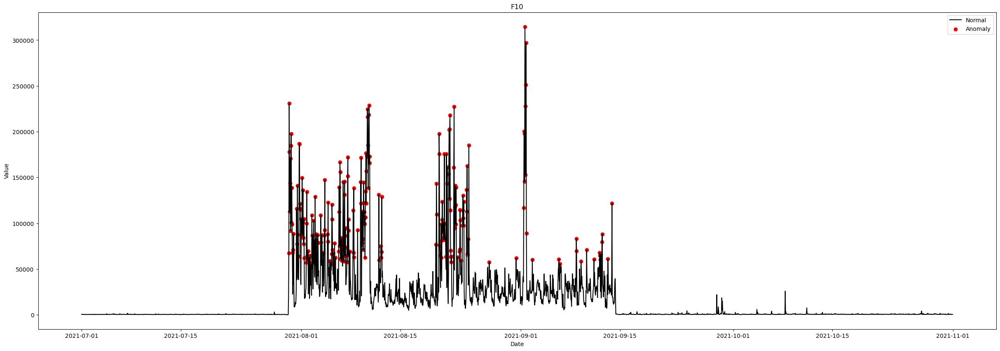

...

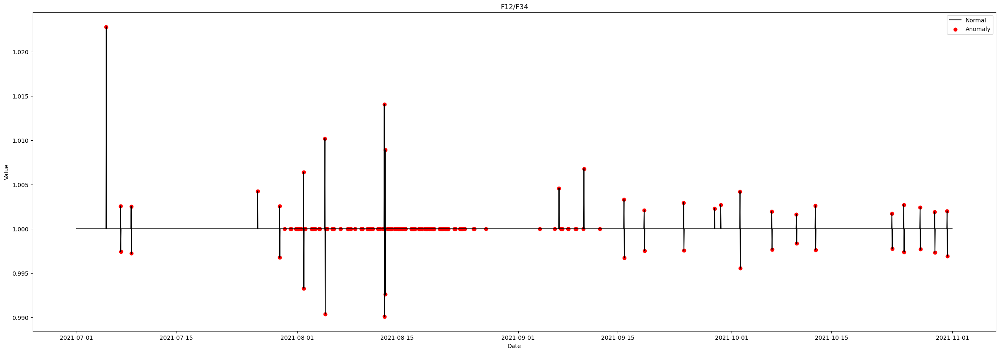

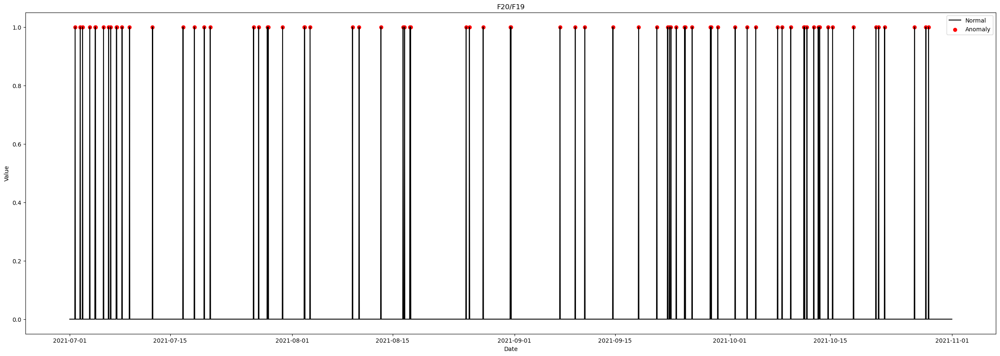

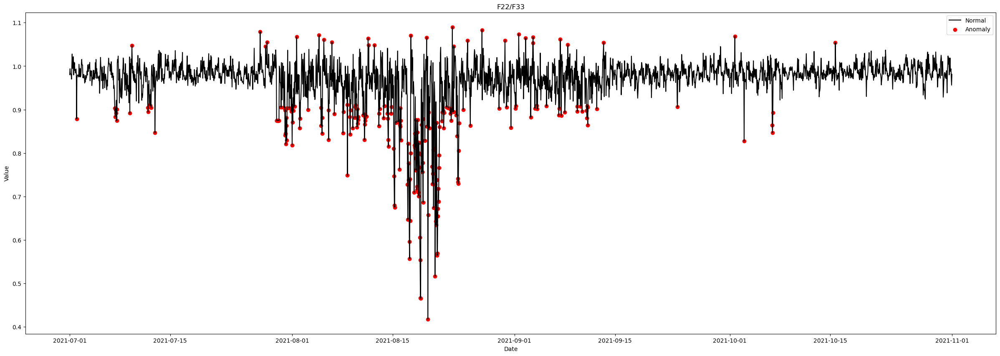

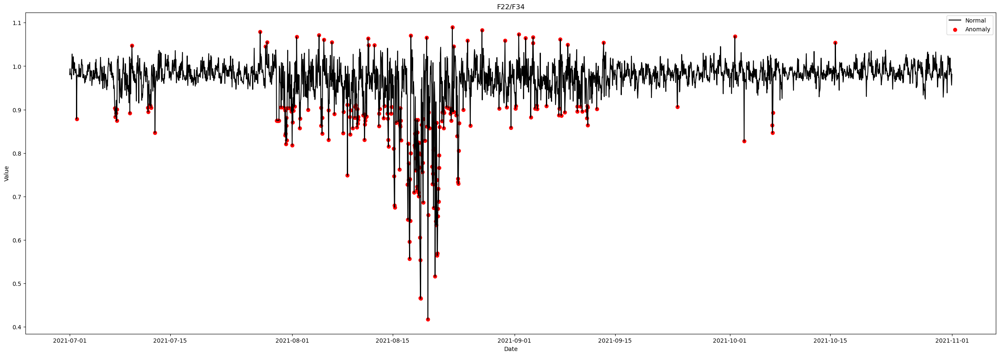

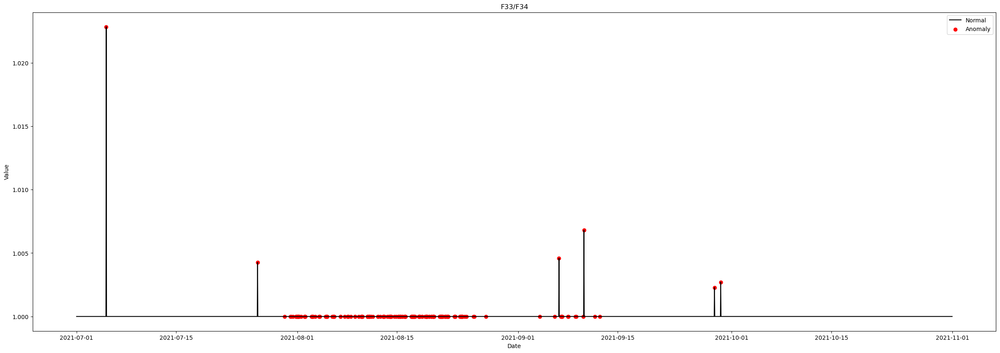

In [7]:
#IQR method to detect anomalies   
for col in df.columns:
    Q3 = np.quantile(df[col], 0.75)
    Q1 = np.quantile(df[col], 0.25)
    IQR = Q3 - Q1
    
    #setting contamination parameter 
    contamination = 0.02 # expected percentage of anomalies
    k = 1.5 / (1 - contamination)
    
    lower_range = Q1 - k* IQR  # extending range based on expected percentage of anomalies
    upper_range = Q3 + k* IQR 
    
    #detecting outliers
    outlier = [x for x in df[col] if ((x <lower_range) | (x > upper_range))]
    a = df.loc[df[col].isin(outlier)]
    
    #plotting graphs
    fig, ax = plt.subplots(figsize=(30,10))
    ax.plot(df.index, df[col], color='black', label = 'Normal')
    ax.scatter(a.index,a[col], color='red', label = 'Anomaly')
    plt.title(col)
    plt.xlabel('Date')
    plt.ylabel('Value')
    plt.legend()
    plt.show()

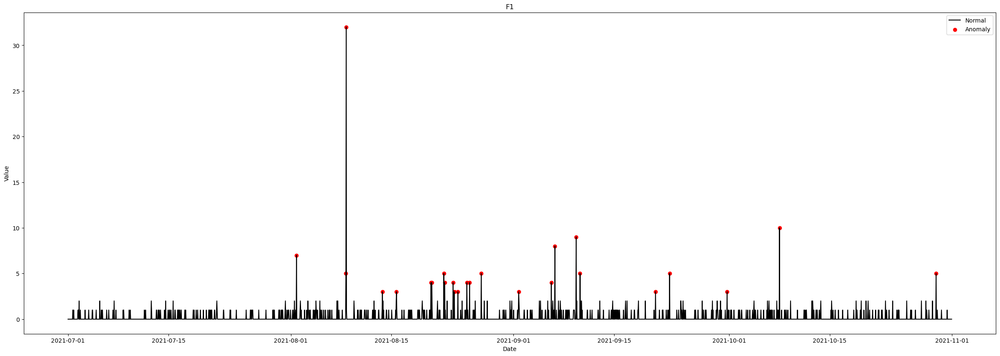

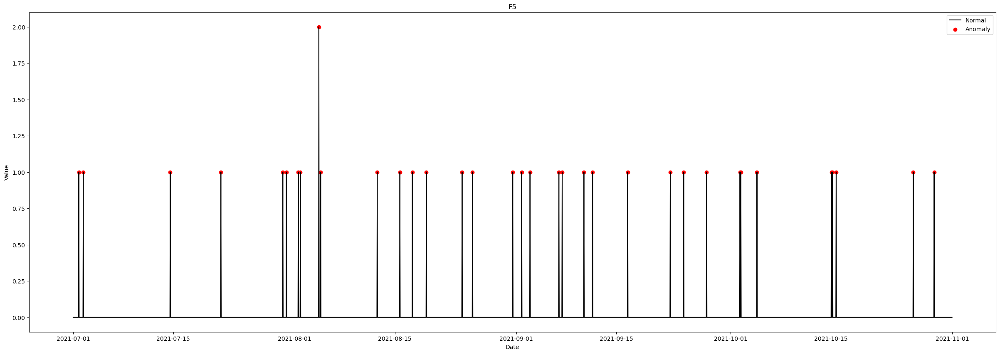

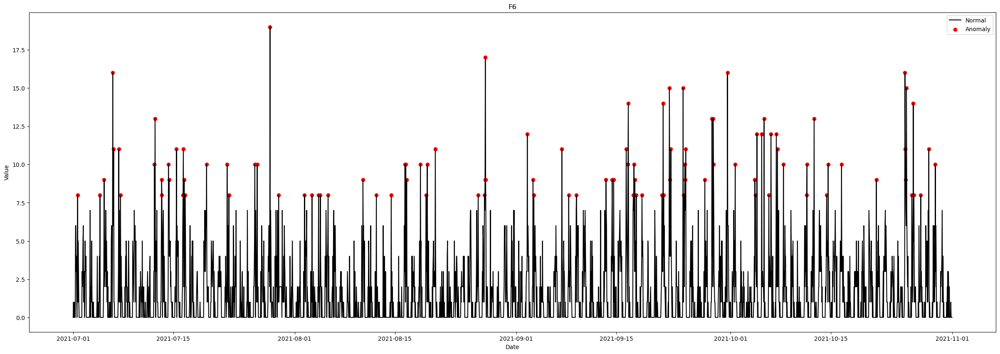

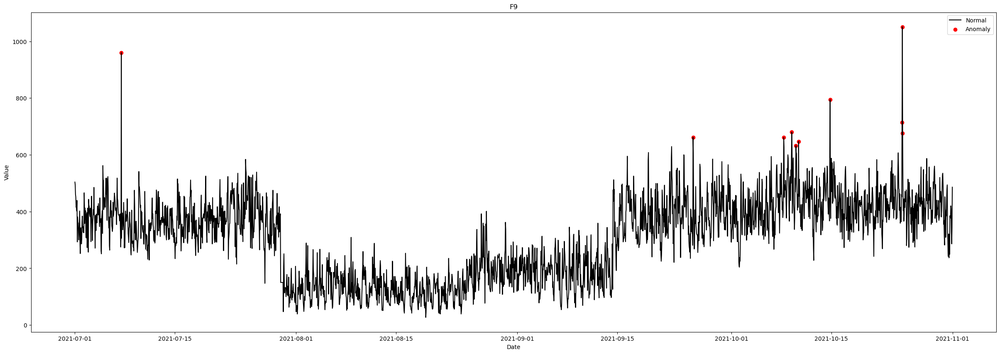

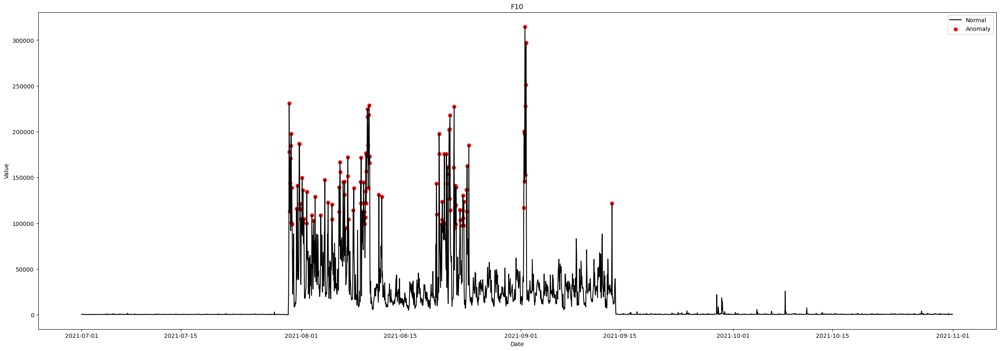

...

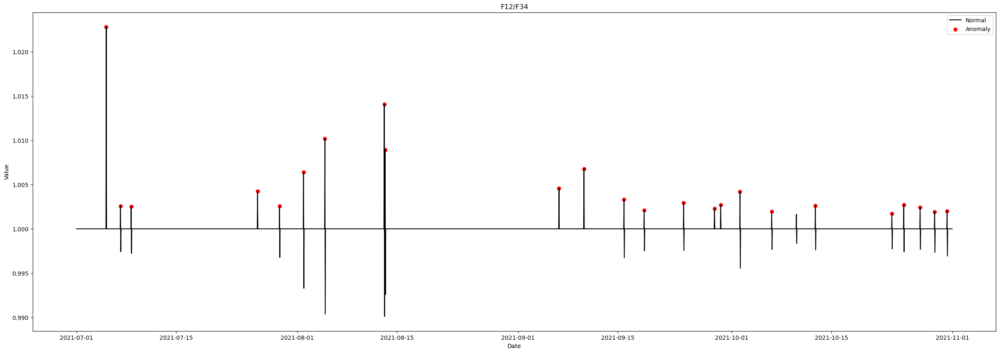

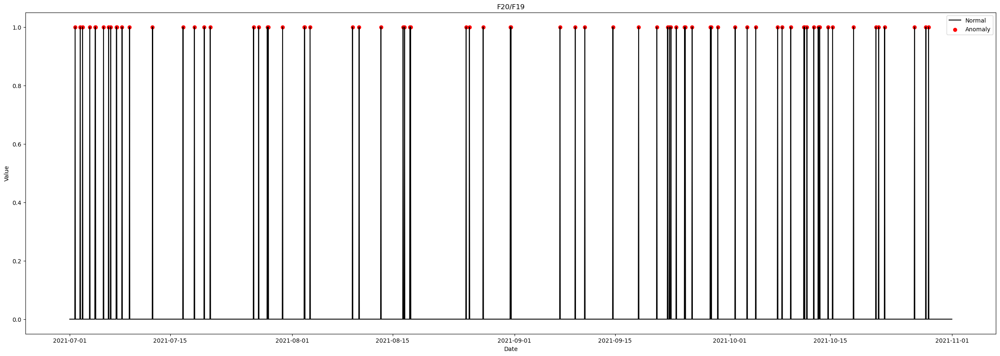

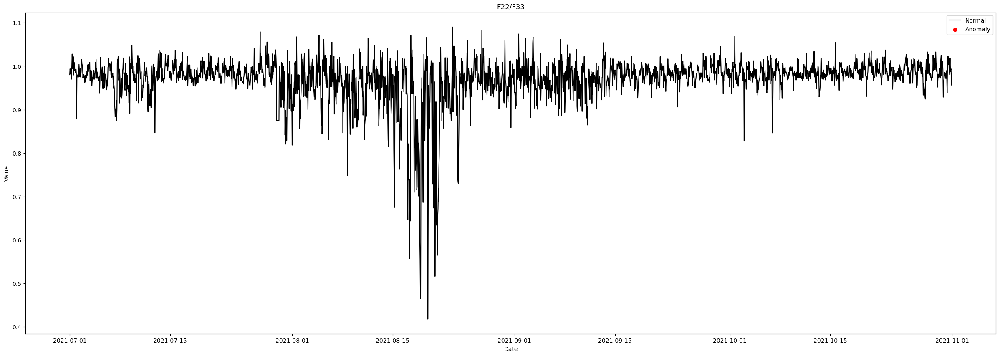

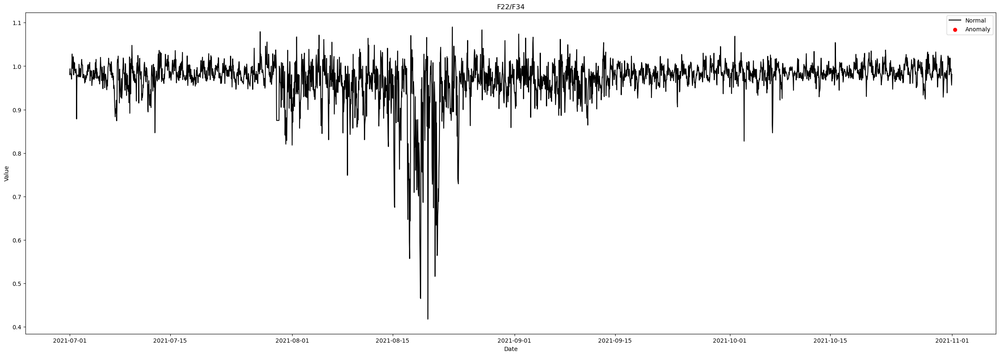

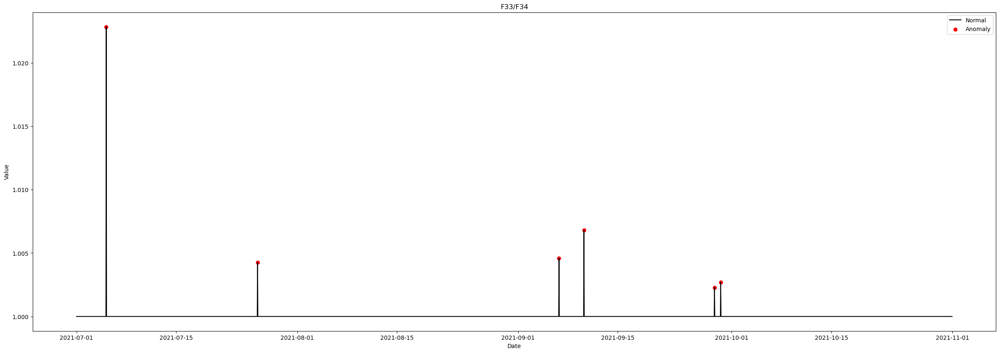

In [8]:
#Z-Score Method
for col in df.columns:
    if col != 'col_zscore':
        df1=df.copy()
        df1['col_zscore'] = (df1[col] - df1[col].mean())/df1[col].std(ddof=0)
    
        #setting contamination parameter and threshold
        contamination = 0.02
        threshold = norm.ppf(1 - contamination / 2)
    
        #detecting outliers
        outlier = [x for x in df1['col_zscore'] if  ((x > threshold))]
        a = df1.loc[df1['col_zscore'].isin(outlier)]
    
        #plotting graphs
        fig, ax = plt.subplots(figsize=(30,10))
        ax.plot(df1.index, df1[col], color='black', label = 'Normal')
        ax.scatter(a.index,a[col], color='red', label = 'Anomaly')
        plt.title(col)
        plt.xlabel('Date')
        plt.ylabel('Value')
        plt.legend()
        plt.show()

In [9]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.stats import t
from math import sqrt

In [12]:
#GRUBBS_TEST
def grubbs_test(df, col, alpha):
    outliers = []
    data = df[col]
    n = len(data)
    mean = np.mean(data)
    std = np.std(data)
    t_critical = t.ppf(1 - alpha / (2 * n), n - 2)
    threshold = (n - 1) / sqrt(n) * sqrt(t_critical ** 2 / (n - 2 + t_critical ** 2))
    while True:
        G = np.abs(data - mean) / std  # calculated
        max_idx = np.argmax(G)
        if G[max_idx] > threshold:
            outliers.append(max_idx)
            try:
                data = np.delete(data, max_idx)
                n -= 1
                mean = np.mean(data)
                std = np.std(data)
                threshold = (n - 1) / np.sqrt(n) * np.sqrt((t.ppf(1 - alpha / (2 * n), n - 2) ** 2) / (n - 2 + t.ppf(1 - alpha / (2 * n), n - 2) ** 2))
            except ValueError:
                break
        else:
            break
    return outliers

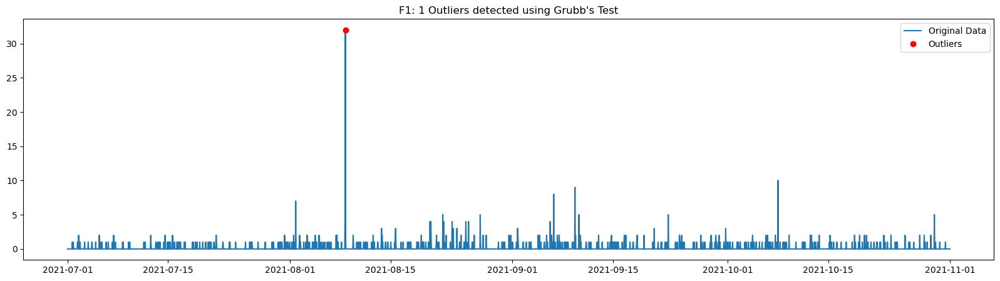

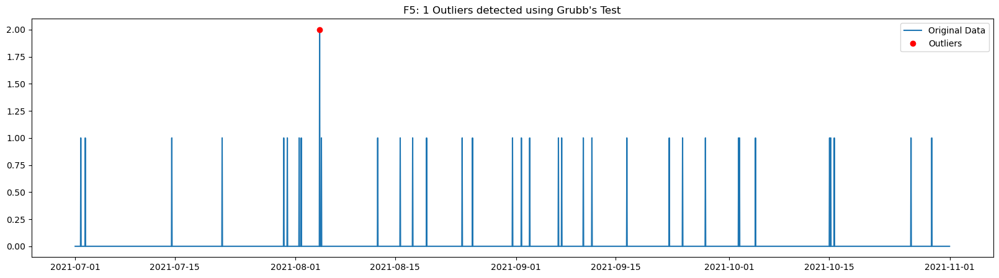

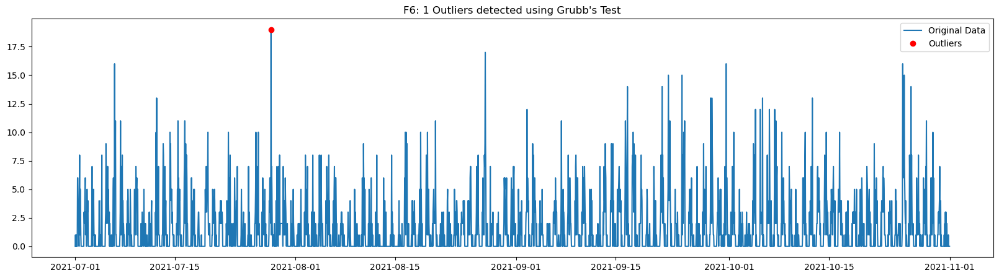

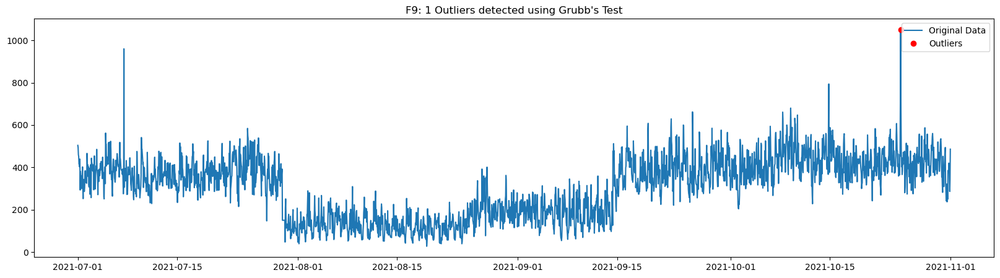

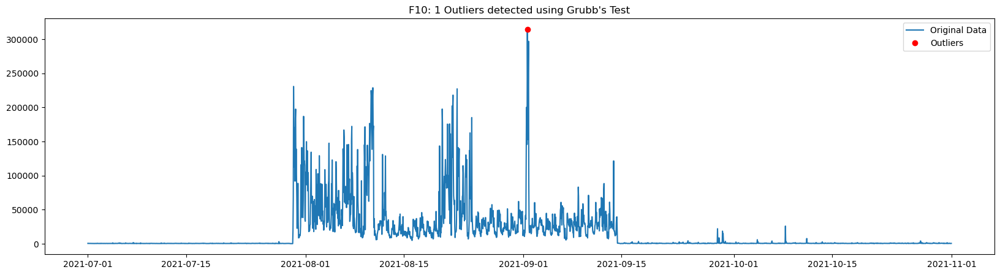

...

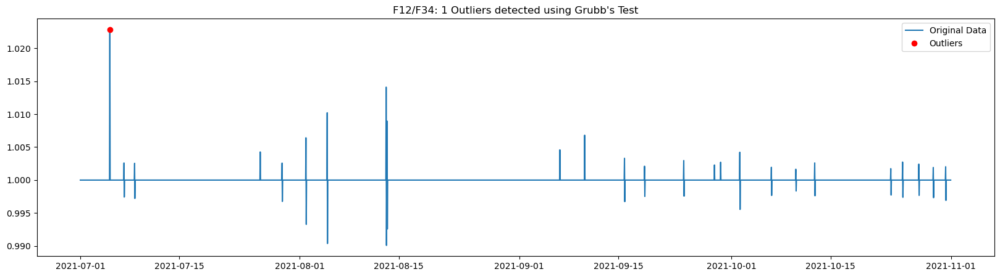

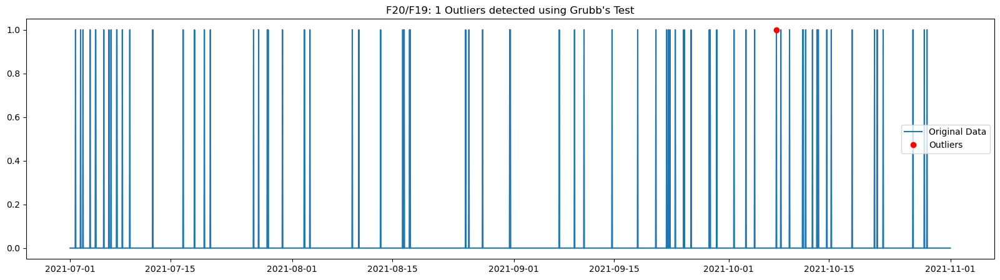

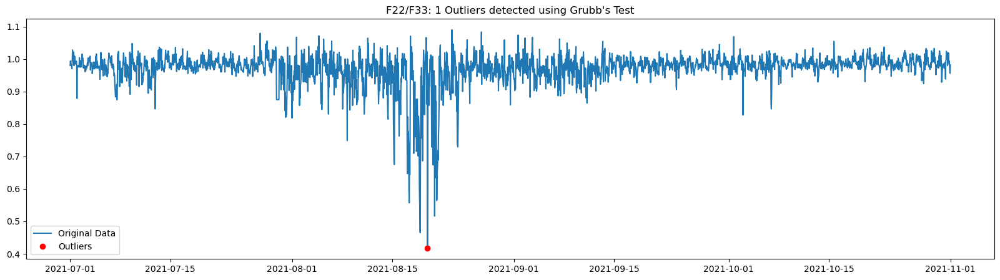

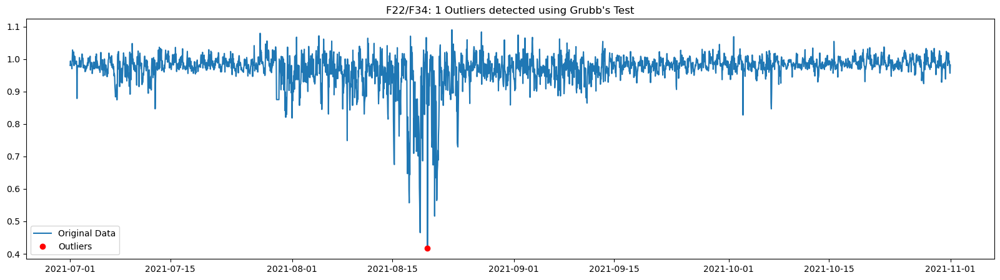

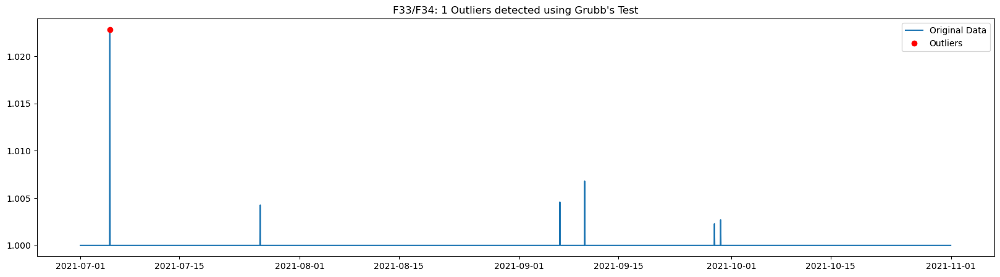

In [13]:
data = pd.read_csv('C:\\Users\\disha\\Downloads\\feature_seln_new123.csv',parse_dates=['START_TIME'])
df=data[data.columns[1:]]
plt.rcParams['figure.figsize'] = [20, 5]
alpha = 0.02
for col in df.columns:
    if col!= 'START_TIME':
        outliers = grubbs_test(df, col, alpha)
        fig, ax = plt.subplots()
        ax.plot(df['START_TIME'], df[col], label='Original Data')
        if outliers:
            ax.plot(df['START_TIME'][outliers], df[col][outliers], 'ro', label='Outliers')
            ax.legend()
            plt.title(f"{col}: {len(outliers)} Outliers detected using Grubb's Test")
        else:
            plt.title(f"{col}: No Outliers detected using Grubb's Test")
        plt.show()

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

In [17]:
data = pd.read_csv('C:\\Users\\disha\\Downloads\\feature_seln_new123.csv', parse_dates=['START_TIME'], index_col='START_TIME')
df=data[data.columns[1:]]

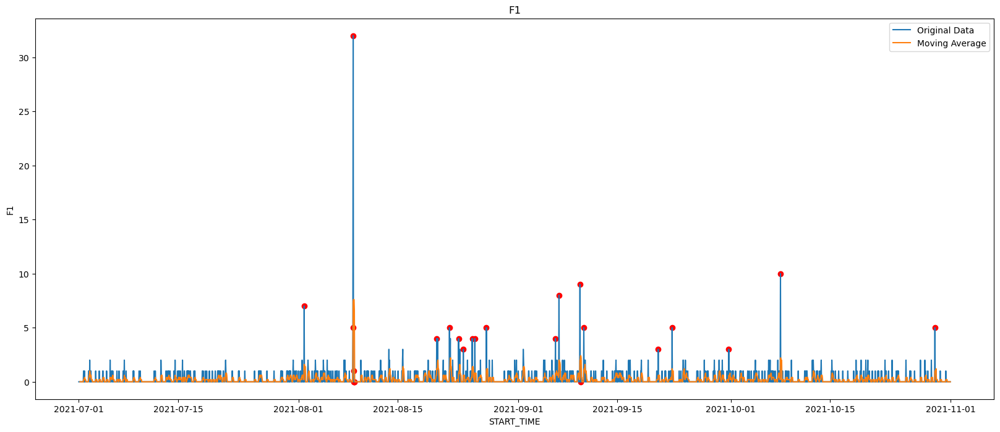

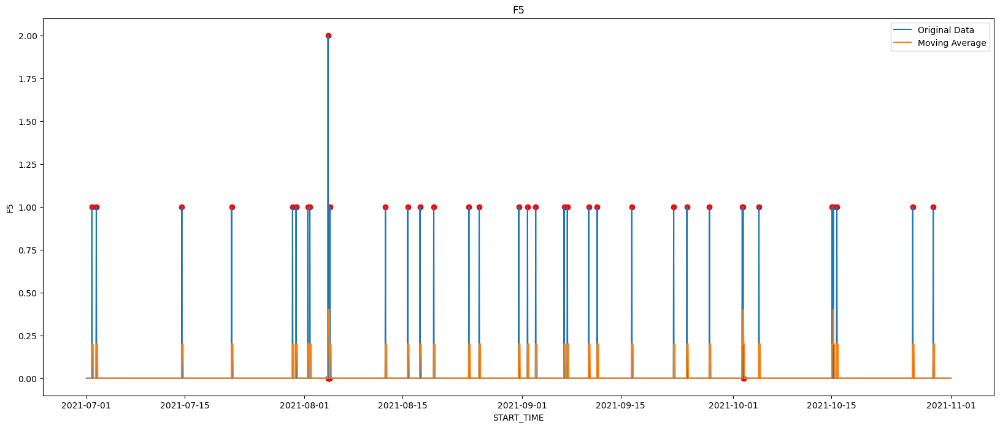

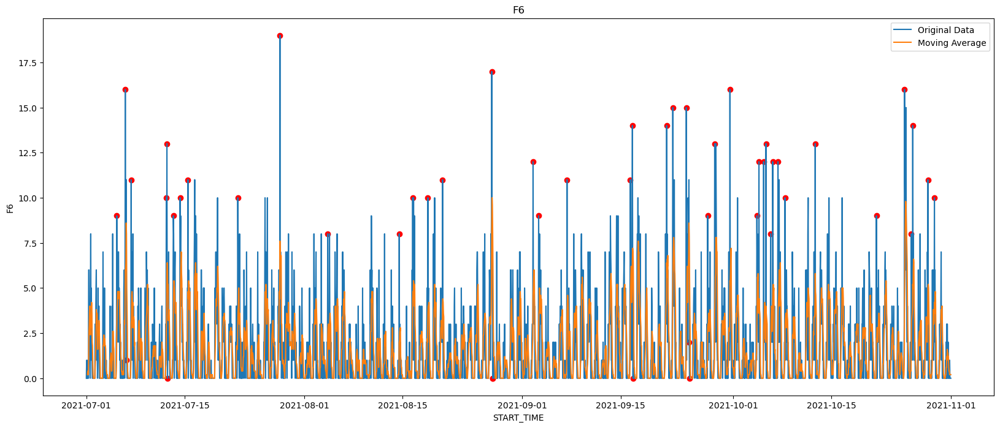

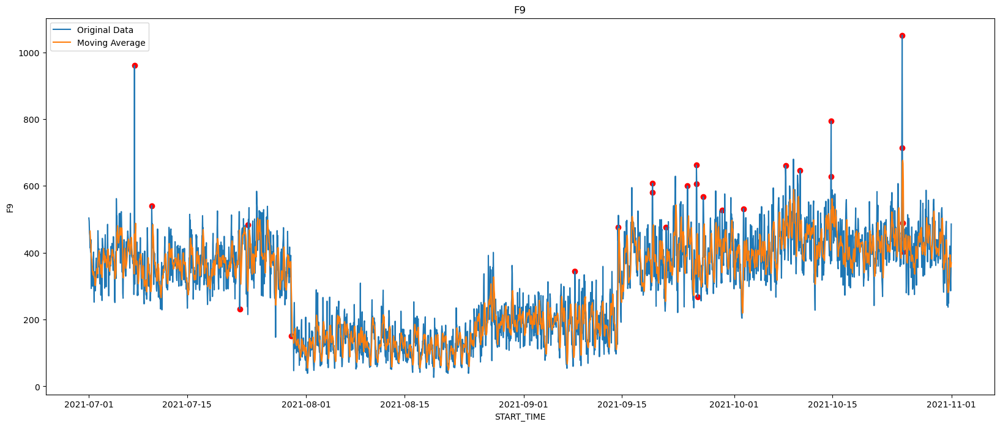

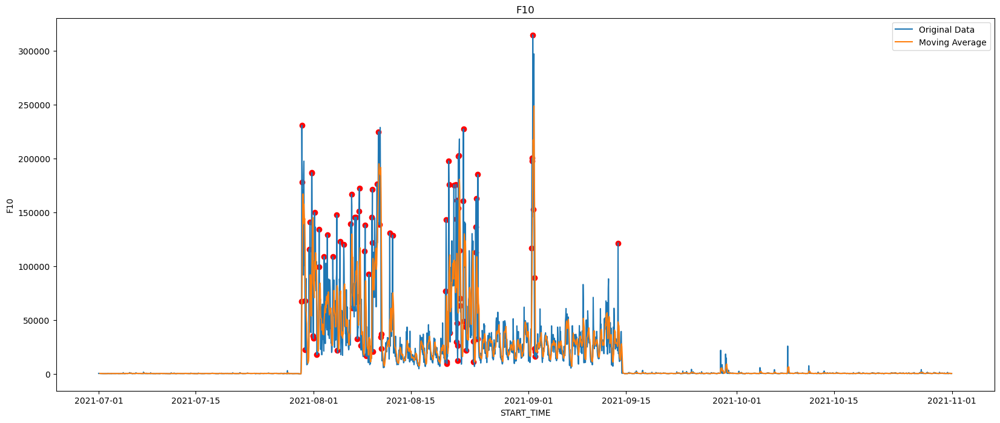

...

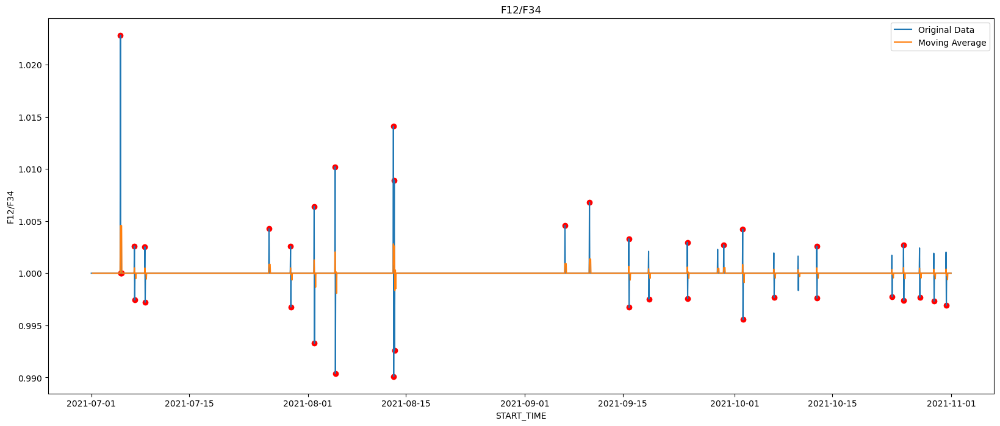

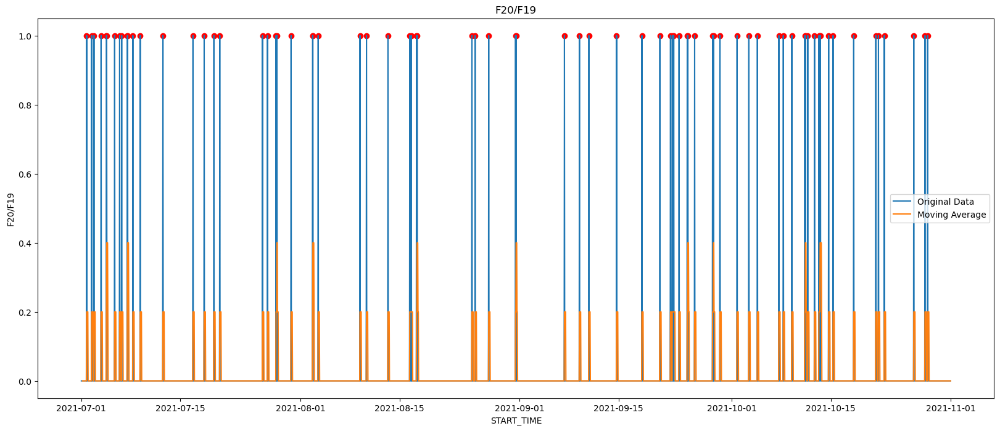

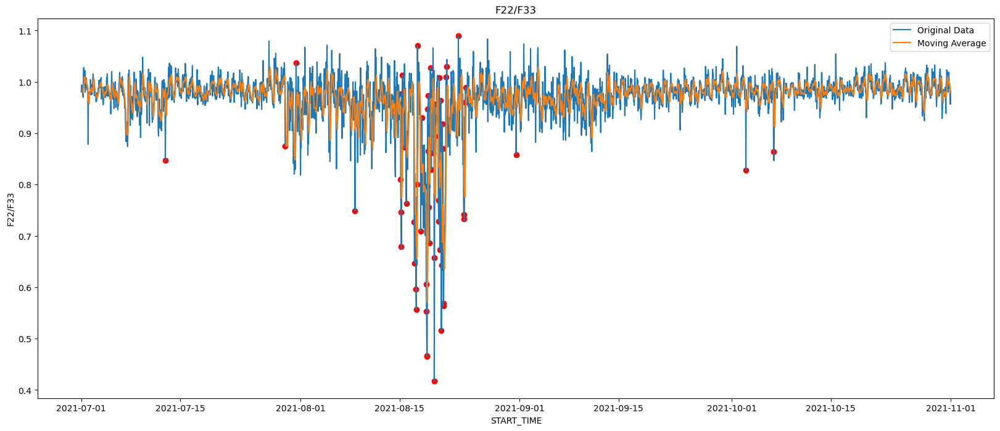

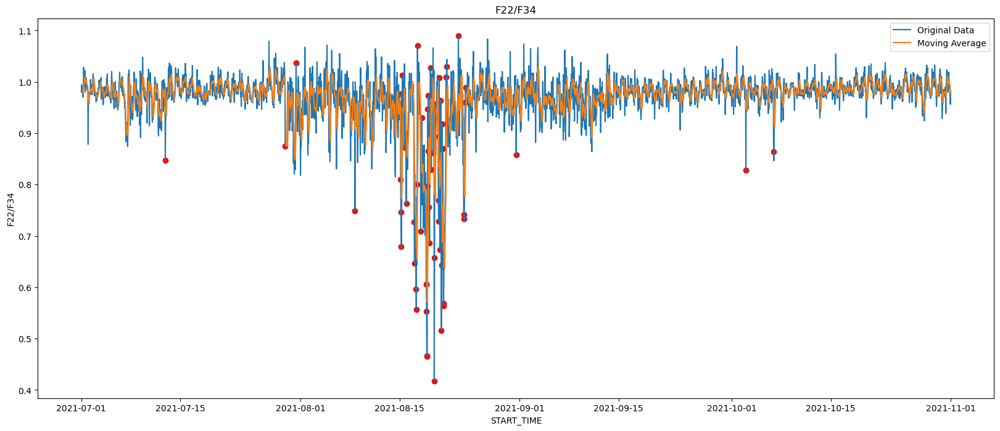

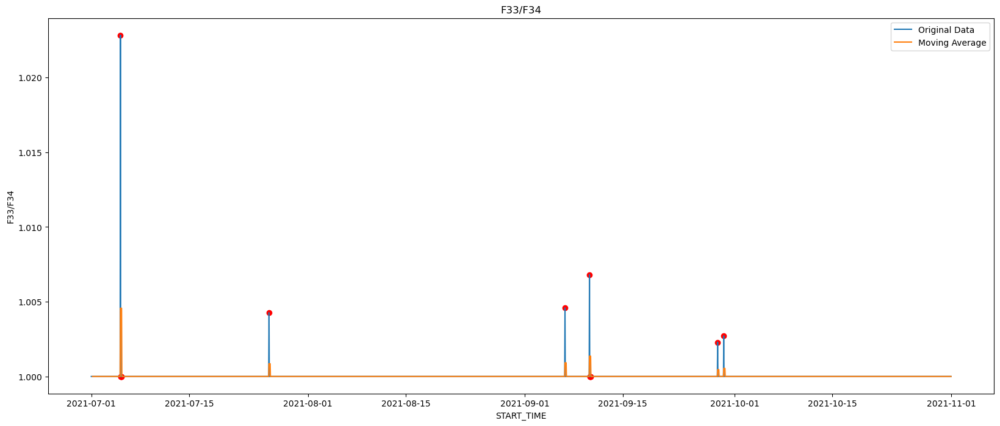

In [18]:
#MOVING AVERAGE METHOD
# calculate the rolling mean using a window of 5 periods
plt.rcParams['figure.figsize'] = [20, 8]
for col in df.columns:
    rolling_mean = df[col].rolling(window=5).mean()
    diff = df[col] - rolling_mean
    std = np.std(diff)
    threshold = 3 * std
    plt.plot(df.index, df[col], label='Original Data')
    plt.plot(rolling_mean.index, rolling_mean, label='Moving Average')
    plt.legend(loc='best')
    anomalies = diff.abs() > threshold
    plt.scatter(df.index[anomalies], df[col][anomalies], color='red', label='Anomalies')
    plt.title(col)
    plt.xlabel('START_TIME')
    plt.ylabel(col)
    plt.show()